In [1]:
# Install and import the required libraries 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Introduction

### Our dataset is about the stats of spotify music from 1986 to 2023

### This dataset contains 35 columns with information about Track, Album, Artist, and Audio

# Variables

* track_name: The name of the song.
* popularity: The song's popularity level on Spotify (popularity score).
* disc_number: The disc number to which the song belongs on an album.
* duration_ms: The duration of the song in milliseconds.
* explicit: Indicates whether the song contains explicit content (True or False).
* track_number: The track number of the song on the album.
* album_name: The name of the album.
* album_release_date: The release date of the album.
* album_type: The type of album (e.g., "album," "single," "compilation," etc.).
* album_total_tracks: The total number of songs on the album.
* artists_names: The names of the artists who perform the song (there can be multiple, separated by semicolons).
* principal_artist_name: The name of the principal artist.
* artist_genres: The music genres associated with the principal artist.
* principal_artist_followers: The number of followers of the principal artist on Spotify.
* acousticness: An indicator of the song's acoustic characteristics.
* danceability: An indicator of how danceable the song is.
* energy: The perceived energy of the song.
* instrumentalness: An indicator of the presence of instrumental elements in the song.
* key: The musical key of the song.
* liveness: An indicator of the likelihood that the song was performed live.
* loudness: The loudness of the song.
* mode: The musical mode of the song.
* speechiness: An indicator of the amount of speech in the song.
* tempo: The tempo of the song.
* time_signature: The time signature of the song.
* valence: A measure of the positivity of the song.
* year: The year in which the song was released. It is of integer type (int64).
* duration_min: The duration of the song in minutes, rather than milliseconds. It is of float type (float64).

In [2]:
df=pd.read_csv('Spotify 2.csv')
df.head()

,Unnamed: 0.1,Unnamed: 0,track_name,popularity,disc_number,duration_ms,explicit,track_number,album_name,album_release_date,...,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,year,duration_min
0,0,0,True Colors,73,1,227600,False,4,True Colors,1986-10-14 00:00:00,...,0.0,0.1160,-13.155,1.0,0.0331,171.282,4.0,0.268,1986,3.793333
1,1,1,Paul Revere,61,1,220840,False,9,Licensed To Ill,1986-11-15 00:00:00,...,6.0,0.2280,-13.232,0.0,0.9440,91.753,4.0,0.578,1986,3.680667
2,2,2,Brass Monkey,68,1,157440,False,11,Licensed To Ill,1986-11-15 00:00:00,...,6.0,0.0992,-8.435,0.0,0.3300,116.371,4.0,0.655,1986,2.624000
3,3,3,Shot in the Dark,66,1,256293,False,9,The Ultimate Sin,1986-02-22 00:00:00,...,6.0,0.1420,-7.262,1.0,0.0324,123.887,3.0,0.619,1986,4.271550
4,4,4,Manic Monday,63,1,184160,False,1,Different Light (Expanded Edition),1986-01-01 00:00:00,...,2.0,0.3580,-10.906,1.0,0.0289,121.761,4.0,0.853,1986,3.069333


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11450 entries, 0 to 11449
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Unnamed: 0.1                11450 non-null  int64  
 1   Unnamed: 0                  11450 non-null  int64  
 2   track_name                  11450 non-null  object 
 3   popularity                  11450 non-null  int64  
 4   disc_number                 11450 non-null  int64  
 5   duration_ms                 11450 non-null  int64  
 6   explicit                    11450 non-null  bool   
 7   track_number                11450 non-null  int64  
 8   album_name                  11450 non-null  object 
 9   album_release_date          11450 non-null  object 
 10  album_type                  11450 non-null  object 
 11  album_total_tracks          11450 non-null  int64  
 12  artists_names               11450 non-null  object 
 13  principal_artist_name       114

In [4]:
df.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'track_name', 'popularity', 'disc_number',
       'duration_ms', 'explicit', 'track_number', 'album_name',
       'album_release_date', 'album_type', 'album_total_tracks',
       'artists_names', 'principal_artist_name', 'artist_genres',
       'principal_artist_followers', 'acousticness', 'danceability', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence', 'year',
       'duration_min'],
      dtype='object')

In [5]:
df.shape

(11450, 30)

In [6]:
print(f'In the Data rows is {df.shape[0]} and column is {df.shape[1]}')

In the Data rows is 11450 and column is 30


In [7]:
df.isna().sum().sort_values(ascending=False)

artist_genres                 117
instrumentalness                5
tempo                           5
speechiness                     5
mode                            5
valence                         5
loudness                        5
liveness                        5
acousticness                    5
key                             5
energy                          5
danceability                    5
time_signature                  5
principal_artist_followers      1
principal_artist_name           0
artists_names                   0
album_total_tracks              0
album_type                      0
album_release_date              0
album_name                      0
track_number                    0
explicit                        0
duration_ms                     0
disc_number                     0
popularity                      0
track_name                      0
Unnamed: 0                      0
Unnamed: 0.1                    0
year                            0
duration_min  

In [8]:
genre=df['artist_genres'].mode()[0]
print(genre)

pop


In [9]:
df['artist_genres'].fillna(genre, inplace=True)
df['artist_genres'].isnull().sum()

0

In [10]:
acoustic=df['acousticness'].mode()[0]
print(acoustic)

0.114


In [11]:
df['acousticness'].fillna(acoustic, inplace=True)
df['acousticness'].isnull().sum()

0

In [12]:
valence=df['valence'].mode()[0]
print(valence)

0.961


In [13]:
df['valence'].fillna(valence, inplace=True)
df['valence'].isnull().sum()

0

In [14]:
time=df['time_signature'].mode()[0]
print(time)

4.0


In [15]:
df['time_signature'].fillna(time, inplace=True)
df['time_signature'].isnull().sum()

0

In [16]:
tempo=df['tempo'].mode()[0]
print(tempo)

0.0


In [17]:
df['tempo'].fillna(tempo, inplace=True)
df['tempo'].isnull().sum()

0

In [18]:
speech=df['speechiness'].mode()[0]
print(speech)

0.0305


In [19]:
df['speechiness'].fillna(speech, inplace=True)
df['speechiness'].isnull().sum()

0

In [20]:
mode=df['mode'].mode()[0]
print(mode)

1.0


In [21]:
df['mode'].fillna(mode, inplace=True)
df['mode'].isnull().sum()

0

In [22]:
loud=df['loudness'].mode()[0]
print(loud)

-6.509


In [23]:
df['loudness'].fillna(loud, inplace=True)
df['loudness'].isnull().sum()

0

In [24]:
live=df['liveness'].mode()[0]
print(live)

0.111


In [25]:
df['liveness'].fillna(live, inplace=True)
df['liveness'].isnull().sum()

0

In [26]:
key=df['key'].mode()[0]
print(key)

7.0


In [27]:
df['key'].fillna(key, inplace=True)
df['key'].isnull().sum()

0

In [28]:
instrument=df['instrumentalness'].mode()[0]
print(instrument)

0.0


In [29]:
df['instrumentalness'].fillna(instrument, inplace=True)
df['instrumentalness'].isnull().sum()

0

In [30]:
energy=df['energy'].mode()[0]
print(energy)

0.768


In [31]:
df['energy'].fillna(energy, inplace=True)
df['energy'].isnull().sum()

0

In [32]:
dance=df['danceability'].mode()[0]
print(dance)

0.551


In [33]:
df['danceability'].fillna(dance, inplace=True)
df['danceability'].isnull().sum()

0

In [34]:
follower=df['principal_artist_followers'].mode()[0]
print(follower)

84618954.0


In [35]:
df['principal_artist_followers'].fillna(follower, inplace=True)
df['principal_artist_followers'].isnull().sum()

0

In [36]:
df.isna().sum().sort_values(ascending=False)

Unnamed: 0.1                  0
Unnamed: 0                    0
track_name                    0
popularity                    0
disc_number                   0
duration_ms                   0
explicit                      0
track_number                  0
album_name                    0
album_release_date            0
album_type                    0
album_total_tracks            0
artists_names                 0
principal_artist_name         0
artist_genres                 0
principal_artist_followers    0
acousticness                  0
danceability                  0
energy                        0
instrumentalness              0
key                           0
liveness                      0
loudness                      0
mode                          0
speechiness                   0
tempo                         0
time_signature                0
valence                       0
year                          0
duration_min                  0
dtype: int64

In [37]:
df.describe()

,Unnamed: 0.1,Unnamed: 0,popularity,disc_number,duration_ms,track_number,album_total_tracks,principal_artist_followers,acousticness,danceability,...,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,year,duration_min
count,11450.000000,11450.000000,11450.000000,11450.000000,1.145000e+04,11450.000000,11450.000000,1.145000e+04,11450.000000,11450.000000,...,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000,11450.000000
mean,5724.500000,719.259825,67.999301,1.017380,2.301816e+05,5.251790,14.206550,9.690021e+06,0.225673,0.610903,...,5.267598,0.182967,-7.533476,0.677817,0.087593,121.015040,3.931616,0.538260,2004.248908,3.836360
std,3305.474626,444.374593,9.334255,0.195043,1.181226e+05,4.415936,9.548194,1.826392e+07,0.261472,0.161300,...,3.543672,0.145018,3.775833,0.467333,0.092973,30.182938,0.352357,0.245022,11.030970,1.968709
min,0.000000,0.000000,44.000000,1.000000,3.349300e+04,1.000000,1.000000,3.100000e+01,0.000000,0.000000,...,0.000000,0.000000,-47.070000,0.000000,0.000000,0.000000,0.000000,0.000000,1986.000000,0.558217
25%,2862.250000,326.000000,61.000000,1.000000,1.917228e+05,2.000000,11.000000,9.069540e+05,0.018300,0.507000,...,2.000000,0.092200,-9.207750,0.000000,0.033900,96.948500,4.000000,0.346000,1995.000000,3.195379
50%,5724.500000,696.000000,68.000000,1.000000,2.232135e+05,4.000000,13.000000,2.901792e+06,0.112000,0.621000,...,5.000000,0.125000,-6.719500,1.000000,0.047300,119.210500,4.000000,0.541000,2004.000000,3.720225
75%,8586.750000,1105.000000,75.000000,1.000000,2.591132e+05,8.000000,16.000000,8.626437e+06,0.362000,0.728000,...,8.000000,0.237000,-5.021000,1.000000,0.093600,140.058750,4.000000,0.736000,2014.000000,4.318554
max,11449.000000,1599.000000,100.000000,10.000000,1.082819e+07,48.000000,176.000000,1.146750e+08,0.996000,0.988000,...,11.000000,0.982000,0.522000,1.000000,0.944000,220.099000,5.000000,0.994000,2023.000000,180.469833


## Pairplot Graph

In [38]:
df.head()

,Unnamed: 0.1,Unnamed: 0,track_name,popularity,disc_number,duration_ms,explicit,track_number,album_name,album_release_date,...,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,year,duration_min
0,0,0,True Colors,73,1,227600,False,4,True Colors,1986-10-14 00:00:00,...,0.0,0.1160,-13.155,1.0,0.0331,171.282,4.0,0.268,1986,3.793333
1,1,1,Paul Revere,61,1,220840,False,9,Licensed To Ill,1986-11-15 00:00:00,...,6.0,0.2280,-13.232,0.0,0.9440,91.753,4.0,0.578,1986,3.680667
2,2,2,Brass Monkey,68,1,157440,False,11,Licensed To Ill,1986-11-15 00:00:00,...,6.0,0.0992,-8.435,0.0,0.3300,116.371,4.0,0.655,1986,2.624000
3,3,3,Shot in the Dark,66,1,256293,False,9,The Ultimate Sin,1986-02-22 00:00:00,...,6.0,0.1420,-7.262,1.0,0.0324,123.887,3.0,0.619,1986,4.271550
4,4,4,Manic Monday,63,1,184160,False,1,Different Light (Expanded Edition),1986-01-01 00:00:00,...,2.0,0.3580,-10.906,1.0,0.0289,121.761,4.0,0.853,1986,3.069333


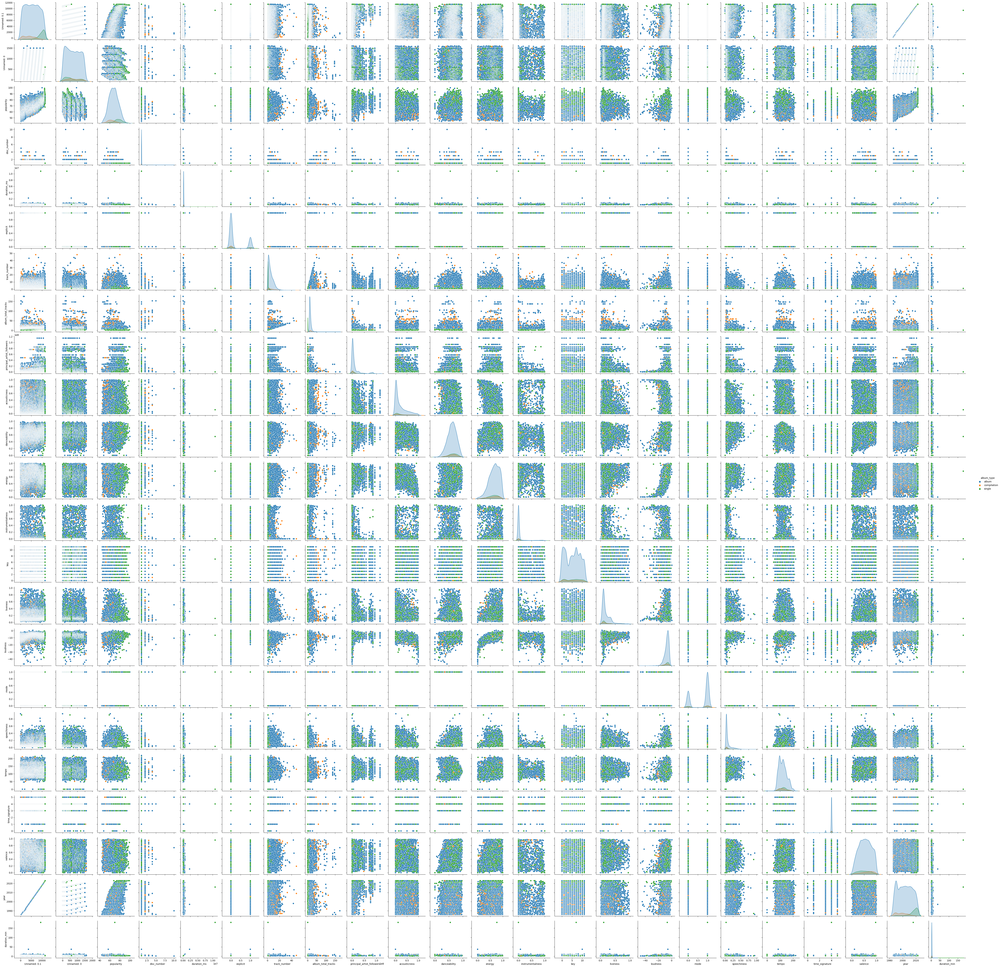

In [39]:
sns.pairplot(df,hue='album_type')

### Observation

* This visualization shows that most songs are albums, a good amount is compilation, and a few are singles from 1986 to 2023.

## Correlation Map

In [40]:
df_new=df[['popularity','loudness', 'tempo']]

In [41]:
corr=df[['popularity','loudness', 'tempo']].corr()

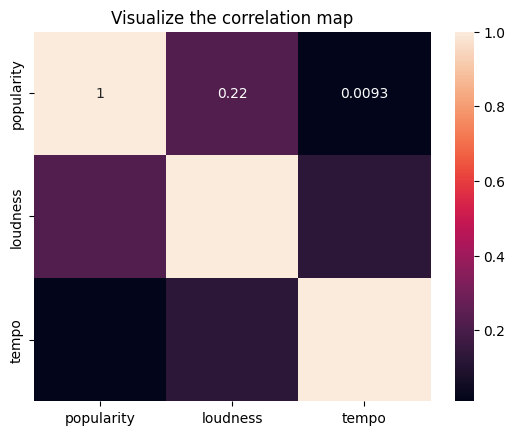

In [42]:
sns.heatmap(corr,annot=True)
plt.title("Visualize the correlation map")
plt.show()

### Observation 

* The correlation map shows a positive correlation in all variables but more substantial in others. For instance, a stronger correlation exists between loudness and popularity than popularity and tempo.

## Identify which year the most songs were created in the data set

In [43]:
df['year'].value_counts()

year
1990    600
1986    300
1987    300
1988    300
1989    300
1991    300
1992    300
1994    300
1995    300
1996    300
1998    300
1997    300
1999    300
2000    300
2004    300
2001    300
2002    300
2003    300
2006    300
2005    300
2007    300
2008    300
2016    300
2009    300
2010    300
2011    300
2012    300
2013    300
2014    300
2015    300
2020    300
2017    300
2018    300
2019    300
2023    300
2022    300
2021    250
1993    100
Name: count, dtype: int64

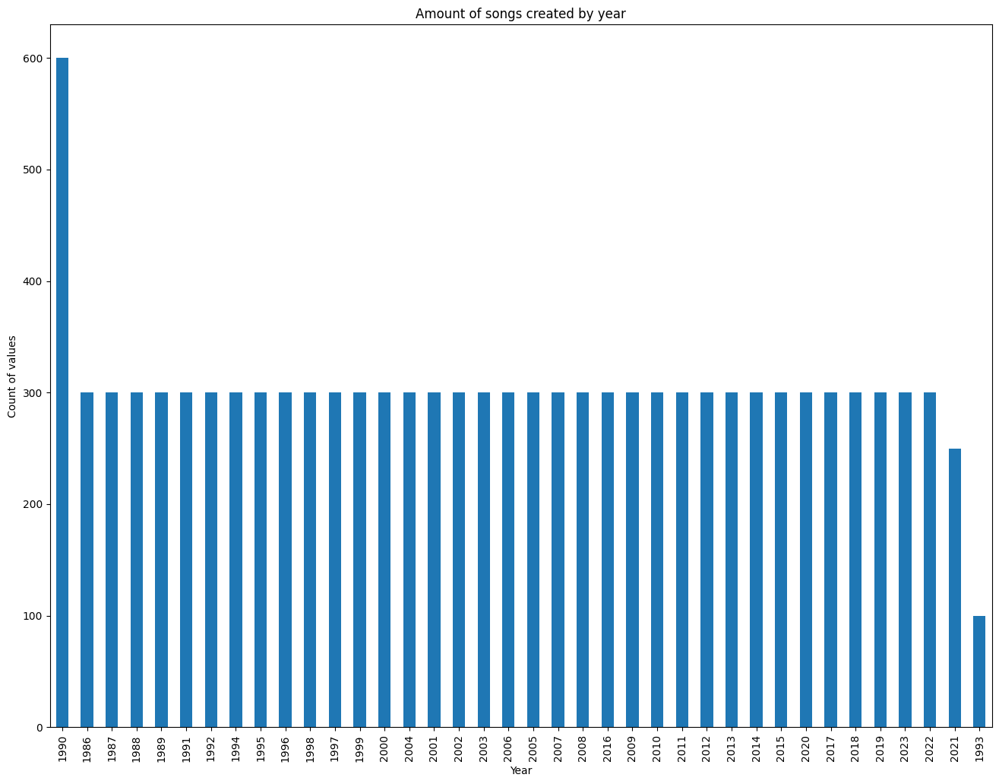

In [44]:
df['year'].value_counts().sort_values(ascending=False)\
.plot(kind='bar',figsize=(16,12),title="Amount of songs created by year")
plt.xlabel("Year")
plt.ylabel("Count of values")
plt.show()

### Observation

* From this observation, 1990 had the most songs (600), while 1993 had the least amount (100). Additionally, the other years in the data set had the same amount of 300 except for 2021, with 250 songs created.

## Identify songs that are explicit or not using a pie chart

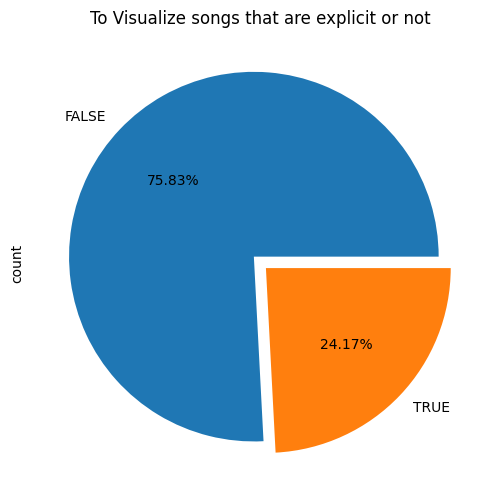

In [45]:
df['explicit'].value_counts().sort_values(ascending=False)\
.plot(kind='pie',figsize=(8,6),title="To Visualize songs that are explicit or not",explode=[0.05,0.04],
    labels=['FALSE','TRUE'],
    autopct='%1.2f%%')
plt.show()

### Observation

* From this visualization, a good number of songs are non-explicit (76%), while there are a few explicit songs (24%) in this data set.

## Understanding a song's tempo while being explicit or not

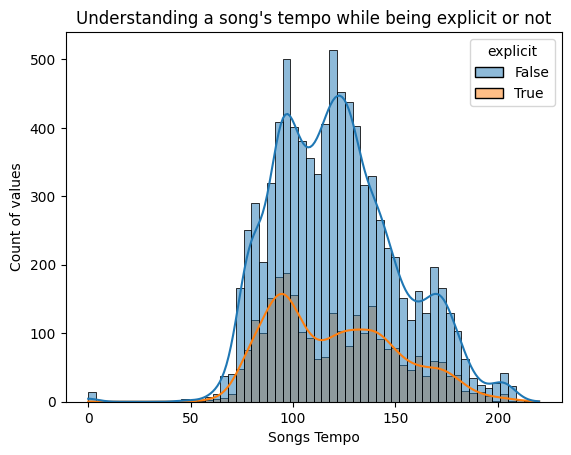

In [46]:
# Kernel density estimate (kde)
sns.histplot(data=df,x='tempo',hue='explicit',kde=True)
plt.title("Understanding a song's tempo while being explicit or not")
plt.xlabel("Songs Tempo")
plt.ylabel("Count of values")
plt.show()

### Observation

* This observation demonstrates that songs without being explicit had a higher tempo than songs with inappropriate music.

### Understanding a song being explicit or not affecting danceability

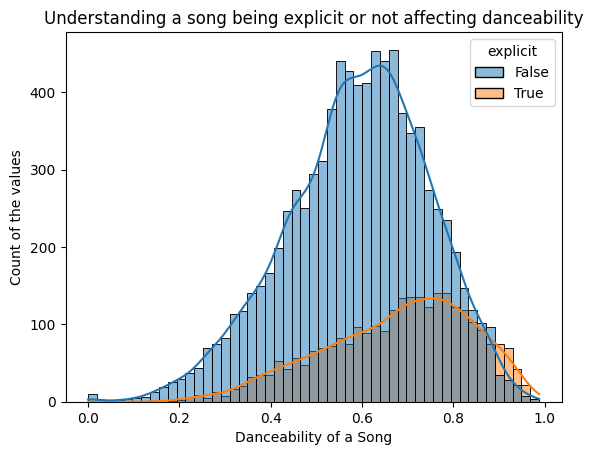

In [47]:
sns.histplot(data=df,x='danceability',hue='explicit',kde=True)
plt.title("Understanding a song being explicit or not affecting danceability")
plt.xlabel("Danceability of a Song")
plt.ylabel("Count of the values")
plt.show()

### Observation

* From this observation, songs with explicit music had a higher danceability measurement than songs being appropriate.

### Relationship between explicit words and instrumentalness

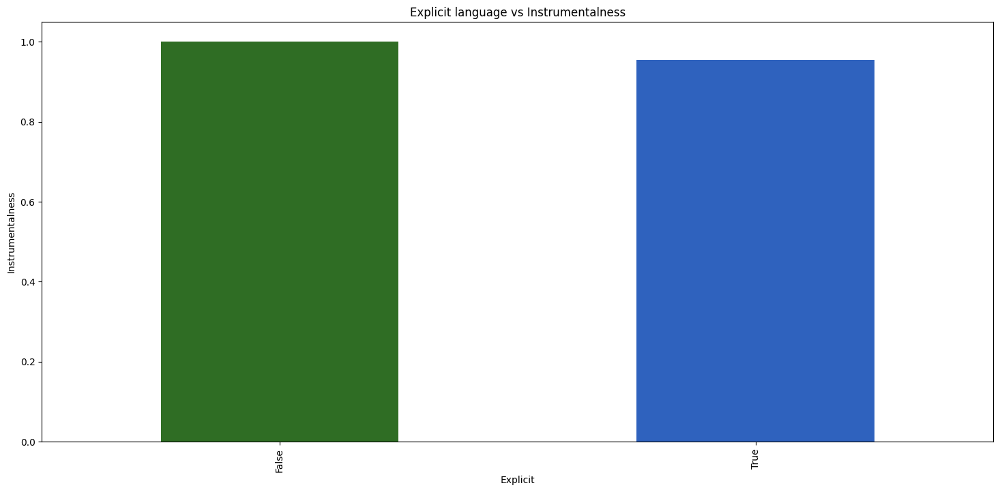

In [48]:
df.groupby(['explicit'])['instrumentalness'].max().sort_values(ascending=False)\
.plot(kind='bar',figsize=(18,8),title="Explicit language vs Instrumentalness",color=['#2F6D24','#2F62BE','#2FBE9C','#3E3491','#F37216','#F31639'])
plt.xlabel("Explicit")
plt.ylabel("Instrumentalness")
plt.xticks(rotation=90)
plt.show()

### Observation

* The bar graph shows that the songs with more instruments has less explicit words than the songs with less instruments

## Relationship between album type and artist followers

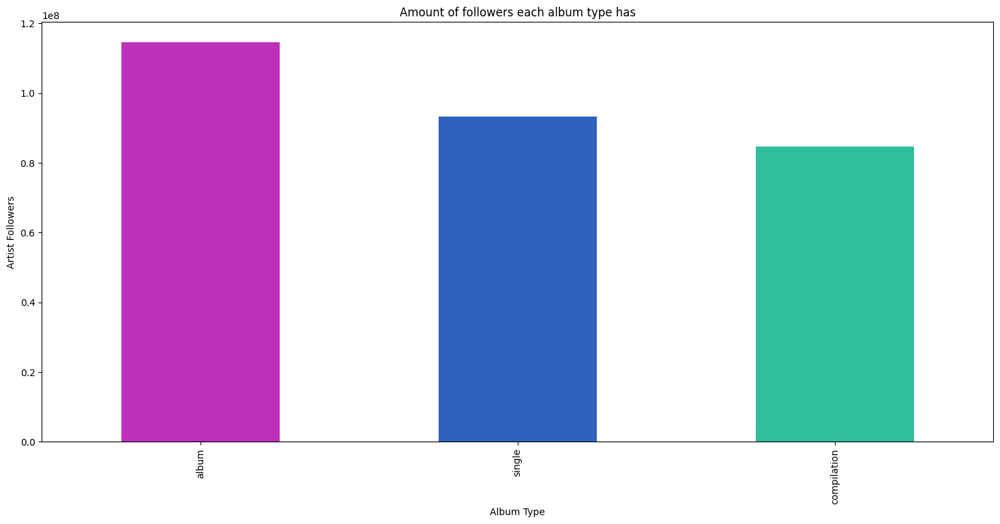

In [49]:
df.groupby(['album_type'])['principal_artist_followers'].max().sort_values(ascending=False)\
.plot(kind='bar',figsize=(18,8),title="Amount of followers each album type has",color=['#BE2FBA','#2F62BE','#2FBE9C','#BE2F5B','#F37216','#F31639'])
plt.xlabel("Album Type")
plt.ylabel("Artist Followers")
plt.xticks(rotation=90)
plt.show()

### Observation

* The bar graph shows that albums have the most followers and compilations have the least amount of followers. This can also tell us that albums are the most popular pick for people

## 10 Most Popular Albums

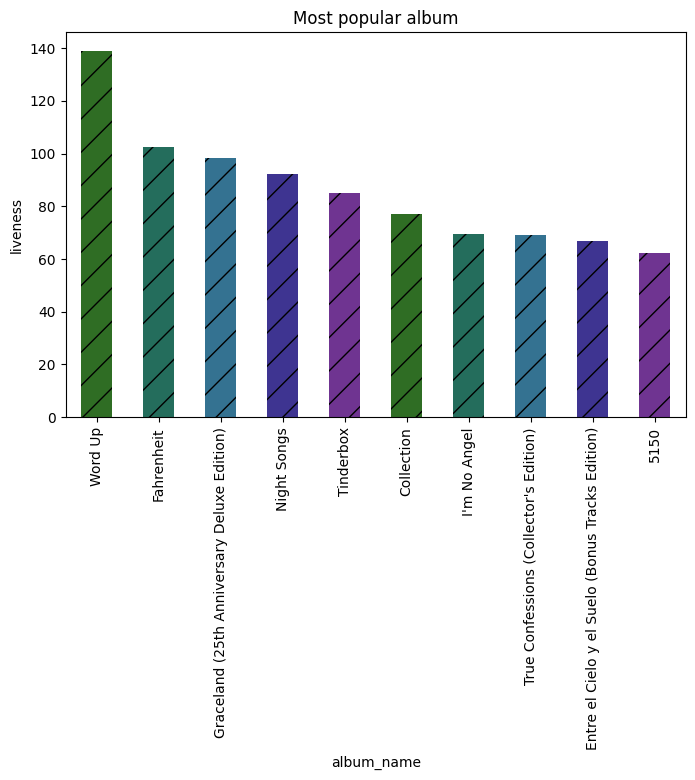

In [50]:
pop=df['popularity']
df.loc[pop].groupby('album_name')['liveness'].sum().sort_values(ascending=False).head(10)\
.plot(kind='bar',title="Most popular album",figsize=(8,5),color=['#2F6D24','#246D5C','#347291','#3E3491','#6F3491'],hatch='/')
plt.xlabel("album_name")
plt.ylabel("liveness")
plt.show()

* This bar graph shows the 10 most popular albums out of the entire dataset. This shows the relationship between the song and the liveness of the song. Word Up has the highest liveness which means there's a lot of energy which gains them a lot of followers

### Observation

* This shows the different album types and the mean of instruments, showing the amount of instruments used

## Proportion Table

In [55]:
import matplotlib.pyplot as plt 
%matplotlib inline 

freq_table = pd.crosstab(df['album_type'], 'acousticness') 

freq_table 


col_0,acousticness
album_type,
album,9815
compilation,708
single,927


### Observation

* This table shows the frequency of each album type. Album is shown the most and single is shown the last

In [57]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [58]:
df.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'track_name', 'popularity', 'disc_number',
       'duration_ms', 'explicit', 'track_number', 'album_name',
       'album_release_date', 'album_type', 'album_total_tracks',
       'artists_names', 'principal_artist_name', 'artist_genres',
       'principal_artist_followers', 'acousticness', 'danceability', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence', 'year',
       'duration_min'],
      dtype='object')

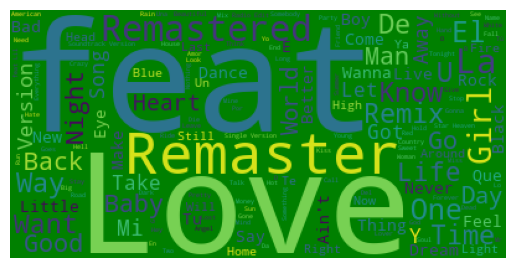

In [59]:
from wordcloud import WordCloud
text3 = ' '.join(df['track_name'])
wordcloud2 = WordCloud(mode='RGB',background_color='green').generate(text3)
# Generate plot
plt.imshow(wordcloud2)
plt.axis("off")
plt.show()